<h1 ><big><center>MSO 3.4 - Deep Structured Learning</center></big></h1>

<h2><big><center> BE 2 - GANs and Diffusion </center></big></h2>

<h5><center>GANs section adapted from the <i>Projet d'Option</i> of : Mhamed Jabri, Martin Chauvin, Ahmed Sahraoui, Zakariae Moustaïne and Taoufik Bouchikhi  
<h5><center>Diffusion section implemented by Bruno Machado<br>


<p align="center">
<img height=300px src="https://cdn-images-1.medium.com/max/1080/0*tJRy5Chmk4XymxwN.png"/></p>
<p align="center"></p>

The aim of this assignment is to discover generative models for images, understand how they are implemented and then explore some specific architectures and training strategies which allows us to perform image generation with and without conditioning (the picture above exemplifies image generation conditioned by another image)

The deliverable for this assignment is this notebook, with the required modifications : 
* In this notebook you'll find <font color='red'>**questions**</font>  that aim to test your understanding of the concepts studied. You should answer them by editing the Markdown cells (or adding new ones). 
* In some of the code cells, you'll have to complete the code and you'll find a "TODO" explaining what you should implement.
* There are also some <font color='green'>**bonus**</font> exercises. Those exercises are **optional** and should be performed only **AFTER** all the rest of the assignment is complete.

# Part 1: DC-GAN

In this part, we aim to learn and understand the basic concepts of **Generative Adversarial Networks** through a DCGAN. For this purpose, please study the following tutorial: https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html


We want to generate handwritten digits using the MNIST dataset. It is available within the torvision package (https://pytorch.org/vision/stable/generated/torchvision.datasets.MNIST.html#torchvision.datasets.MNIST)

Adapt the code given in the tutorial in order to use it with the MNIST dataset. Present the loss curves in function of the gradient steps for the generator and discriminator and also compare the generated images with the images from the dataset.

In [3]:
# TODO: adapt the code from the tutorial to experiment on the MNIST dataset

In [1]:
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Set random seed for reproducibility
# manualSeed = 999
manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)
torch.use_deterministic_algorithms(True) # Needed for reproducible results

Random Seed:  8017


In [5]:
# Root directory for dataset
dataroot = "data"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 1

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 5

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

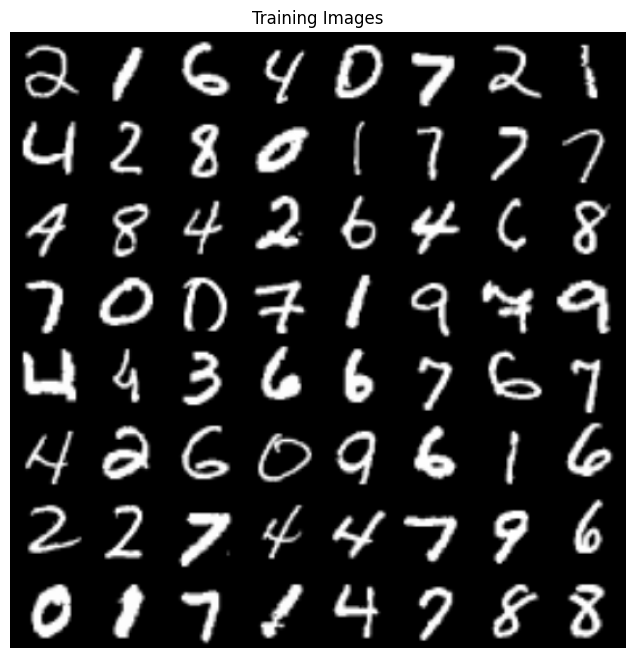

In [6]:
# Load MNIST dataset

data = dset.MNIST('data', 
                  download=True, 
                  transform=transforms.Compose([
                      transforms.Resize(image_size),
                      transforms.CenterCrop(image_size),
                      transforms.ToTensor(),
                      transforms.Normalize((0.5,), (0.5,)),
                    ]),
                )

dataloader = torch.utils.data.DataLoader(data, batch_size=batch_size, shuffle=True, num_workers=workers)

device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

In [7]:
# custom weights initialization called on ``netG`` and ``netD``
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [8]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. ``(ngf*8) x 4 x 4``
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. ``(ngf*4) x 8 x 8``
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. ``(ngf*2) x 16 x 16``
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. ``(ngf) x 32 x 32``
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 64 x 64``
        )

    def forward(self, input):
        return self.main(input)

In [9]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
#  to ``mean=0``, ``stdev=0.02``.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 1, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [10]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is ``(nc) x 64 x 64``
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf) x 32 x 32``
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*2) x 16 x 16``
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*4) x 8 x 8``
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*8) x 4 x 4``
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [11]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
# like this: ``to mean=0, stdev=0.2``.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(1, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [12]:
# Initialize the ``BCELoss`` function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [13]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

netG.save_state_dict('models/generator_part_1.pth')
netD.save_state_dict('models/discriminator_part_1.pth')

Starting Training Loop...
[0/5][0/469]	Loss_D: 1.9525	Loss_G: 4.8176	D(x): 0.5823	D(G(z)): 0.6762 / 0.0122
[0/5][50/469]	Loss_D: 0.0958	Loss_G: 8.2579	D(x): 0.9672	D(G(z)): 0.0397 / 0.0004
[0/5][100/469]	Loss_D: 0.0266	Loss_G: 7.0618	D(x): 0.9861	D(G(z)): 0.0089 / 0.0011
[0/5][150/469]	Loss_D: 39.7139	Loss_G: 53.7672	D(x): 0.0000	D(G(z)): 0.0000 / 0.0000
[0/5][200/469]	Loss_D: 0.3241	Loss_G: 5.0365	D(x): 0.8335	D(G(z)): 0.0719 / 0.0158
[0/5][250/469]	Loss_D: 0.3046	Loss_G: 3.8136	D(x): 0.8845	D(G(z)): 0.1337 / 0.0335
[0/5][300/469]	Loss_D: 4.8009	Loss_G: 1.6020	D(x): 0.0373	D(G(z)): 0.0000 / 0.3388
[0/5][350/469]	Loss_D: 0.3533	Loss_G: 4.3615	D(x): 0.9090	D(G(z)): 0.2059 / 0.0196
[0/5][400/469]	Loss_D: 0.2044	Loss_G: 3.0291	D(x): 0.8904	D(G(z)): 0.0680 / 0.0687
[0/5][450/469]	Loss_D: 0.1622	Loss_G: 4.4891	D(x): 0.9714	D(G(z)): 0.1140 / 0.0206
[1/5][0/469]	Loss_D: 0.8430	Loss_G: 13.5816	D(x): 0.9967	D(G(z)): 0.5110 / 0.0000
[1/5][50/469]	Loss_D: 0.1555	Loss_G: 3.7746	D(x): 0.9592	D(G(z)

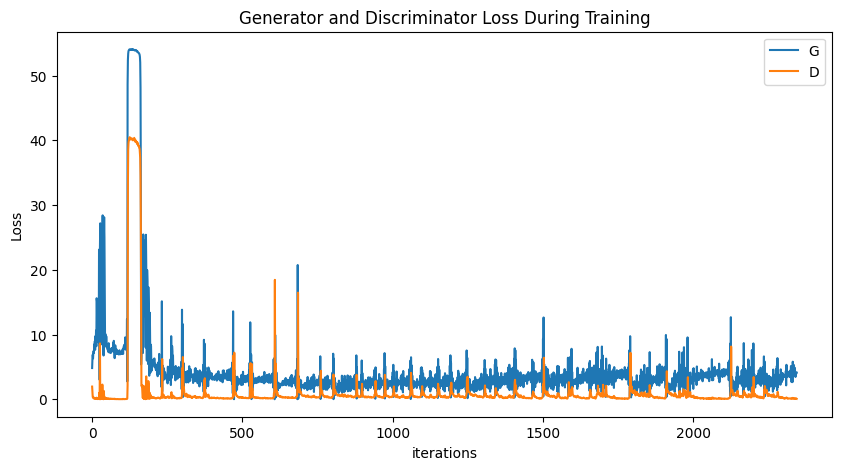

In [14]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

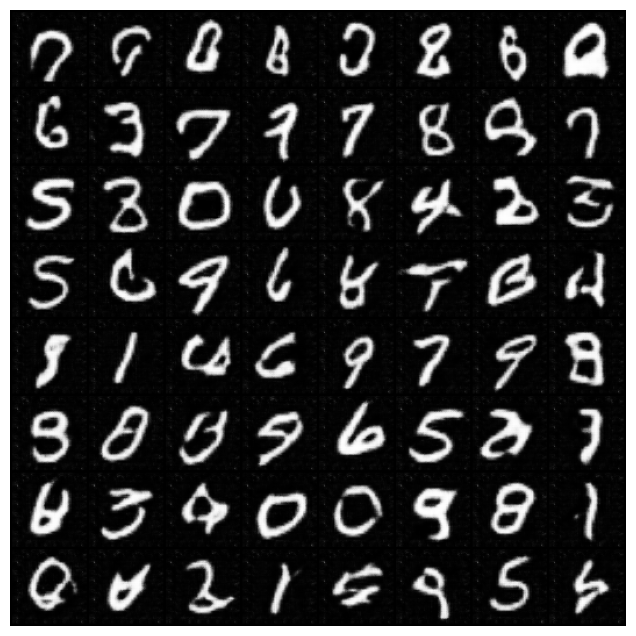

In [15]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

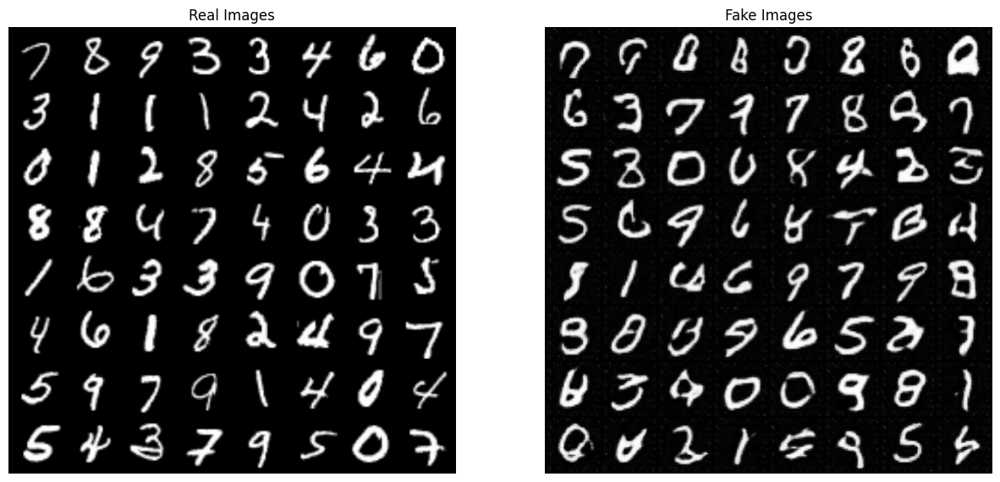

In [16]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

The results for some images might be convincing, but probably you can spot some bad results as well. We will see how we can use different architectures and training objectives to get better results. More importantly, we generate images directly from noise, not knowing what number (if any) will come out on the output.

<font color='red'>**Question**</font>  
How could we change the architecture above to control which number the generator should output ?

To control which number the generator should output, we can use a conditionnal GAN (cGAN), which takes has input, in addition to the noise, a one hot array that represent the number we want to generate.
We make this change for the generator and the discriminator.

https://ai.stackexchange.com/questions/41563/implementing-a-gan-with-control-over-the-output-class

<font color='green'>**Bonus**</font>   
**Copy** the code you implemented above into a new Python cell and adapt it to implement your idea to control the number the generator outputs. Plot the training loss curves and a few examples of your model's outputs (e.g. generate(number=7) # Generates a handwritten 7). Note that we still want to be able to generate different images of the same class ! (i.e. generate(number=4) shoud not generate always the same handwritten 4, but a different one at each time)  

# Part 2: Conditional GAN (cGAN)

Let's take the example of the set described in the following picture:  

<p align="center">
<img height=300px src="https://raw.githubusercontent.com/Neyri/Projet-cGAN/master/BE/img/map_streetview.png"/></p>
<p align="center"></p>

We have a picture of a map (from Google Maps) and we want to create an image of what the satellite view may look like.

Therefore, we do not only want to generate a picture from random noise, but rather generate a picture from another picture. For this purpose we will use a cGAN instead of a vanilla GAN, which was introduced in this [paper](https://arxiv.org/pdf/1611.07004.pdf).

A cGAN is a supervised GAN aiming at mapping a label picture to a real one or a real picture to a label one. As you can see in the diagram below, the discriminator will take as input a pair of images and try to predict if the pair was generated or not. The generator will not generate an image from noise but will intead use an image (label or real) to generate another one (real or label).  

<p align="center">
<img height=300px src="https://raw.githubusercontent.com/Neyri/Projet-cGAN/master/BE/img/cgan_map.png"/></p>
<p align="center"></p>

### Generator

In the cGAN architecture, the generator chosen is a U-Net.

<p align="center">
<img height=300px src="https://raw.githubusercontent.com/Neyri/Projet-cGAN/master/BE/img/unet.png"/></p>
<p align="center"></p>

A U-Net takes as input an image, and outputs another image. 

It can be divided into 2 subparts : an encoder and a decoder. 
* The encoder takes the input image and reduces its dimension to encode the main features into a vector. 
* The decoder takes this vector and map the features stored into an image.

A U-Net architecture is different from a vanilla convolutional encoder-decoder in that every layer of the decoder takes as input the previous decoded output as well as the output feature map from the encoder layers of the same level. This allows the decoder to map low frequencies information encoded during the descent as well as high frequencies from the original picture. 

<p align="center">
<img height=300px src="https://www.researchgate.net/profile/Baris_Turkbey/publication/315514772/figure/fig2/AS:485824962797569@1492841105670/U-net-architecture-Each-box-corresponds-to-a-multi-channel-features-maps-The-number-of.png"/></p>
<p align="center"></p>

The architecture we will implement is the following (the number in the square is the number of filters used).

<p align="center">
<img height=300px src="https://raw.githubusercontent.com/Neyri/Projet-cGAN/master/BE/img/unet_architecture.png"/></p>
<p align="center"></p>

The encoder will take as input a colored picture (3 channels: RGB), it will pass through a series of convolution layers to encode the features of the picture. It will then be decoded by the decoder using transposed convolutional layers. These layers will take as input the previous decoded vector AND the encoded features of the same level. 

For this part the objective is to use a cGAN to generate facades from a template image. For this purpose, we will use the "Facade" dataset.

<p align="center">
<img height=250px src="https://storage.googleapis.com/kaggle-datasets-images/926166/1567332/1fd1b7ec805d92b48a1227c376044d0b/dataset-cover.png"/></p>
<p align="center"></p>

Let's start by creating a few classes describing the layers we will use in the U-Net.

In [2]:
# Importing all the libraries needed
import os
import glob
import torch
import kagglehub

import numpy as np
import matplotlib.pyplot as plt
import torchvision.transforms as transforms

from torch import nn
from PIL import Image
from torch.utils.data import Dataset, DataLoader

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [3]:
# code adapted from https://github.com/milesial/Pytorch-UNet/blob/master/unet/unet_parts.py

# Input layer
class inconv(nn.Module):
    def __init__(self, in_ch, out_ch):
        super(inconv, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, kernel_size=4, padding=1, stride=2),
            nn.LeakyReLU(negative_slope=0.2, inplace=True)
        )

    def forward(self, x):
        x = self.conv(x)
        return x

# Encoder layer
class down(nn.Module):
    def __init__(self, in_ch, out_ch):
        super(down, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, kernel_size=4, padding=1, stride=2),
            nn.BatchNorm2d(out_ch),
            nn.LeakyReLU(negative_slope=0.2, inplace=True)
        )

    def forward(self, x):
        x = self.conv(x)
        return x

# Decoder layer
class up(nn.Module):
    def __init__(self, in_ch, out_ch, dropout=False):
        super(up, self).__init__()
        if dropout :
            self.conv = nn.Sequential(
                nn.ConvTranspose2d(in_ch, out_ch, kernel_size=4, padding=1, stride=2),
                nn.BatchNorm2d(out_ch),
                nn.Dropout(0.5, inplace=True),
                nn.ReLU(inplace=True)
            )
        else:
            self.conv = nn.Sequential(
                nn.ConvTranspose2d(in_ch, out_ch, kernel_size=4, padding=1, stride=2),
                nn.BatchNorm2d(out_ch),
                nn.ReLU(inplace=True)
            )

    def forward(self, x1, x2):
        x1 = self.conv(x1)
        x = torch.cat([x1, x2], dim=1)
        return x

# Output layer
class outconv(nn.Module):
    def __init__(self, in_ch, out_ch):
        super(outconv, self).__init__()
        self.conv = nn.Sequential(
              nn.ConvTranspose2d(in_ch, out_ch, kernel_size=4, padding=1, stride=2),
              nn.Tanh()
        )

    def forward(self, x):
        x = self.conv(x)
        return x

Now let's create the U-Net using the helper classes defined previously.

In [4]:
class U_Net(nn.Module):
    ''' 
    Ck denotes a Convolution-BatchNorm-ReLU layer with k filters.
    CDk denotes a Convolution-BatchNorm-Dropout-ReLU layer with a dropout rate of 50%
    Encoder:
      C64   - C128   - C256   - C512  - C512  - C512 - C512 - C512
    Decoder:
      CD512 - CD1024 - CD1024 - C1024 - C1024 - C512 - C256 - C128
    '''
    def __init__(self, n_channels, n_classes):
        super(U_Net, self).__init__()
        # Encoder
        self.inc = inconv(n_channels, 64) # 64 filters
        # TODO :
        # Create the 7 encoder layers called "down1" to "down7" following this sequence
        # C64   - C128   - C256   - C512  - C512  - C512 - C512 - C512
        # The first one has already been implemented
        self.down1 = down(64, 128)
        self.down2 = down(128, 256)
        self.down3 = down(256, 512)
        self.down4 = down(512, 512)
        self.down5 = down(512, 512)
        self.down6 = down(512, 512)
        self.down7 = down(512, 512)
        
        
        # Decoder
        # TODO :
        # Create the 7 decoder layers called up1 to up7 following this sequence :
        # CD512 - CD1024 - CD1024 - C1024 - C1024 - C512 - C256 - C128
        # The last layer has already been defined
        self.up7 = up(512, 512)
        self.up6 = up(1024, 512)
        self.up5 = up(1024, 512)
        self.up4 = up(1024, 512)
        self.up3 = up(1024, 256)
        self.up2 = up(512, 128)
        self.up1 = up(256, 64)
        
        
        self.outc = outconv(128, n_classes) # 128 filters

    def forward(self, x):
        x1 = self.inc(x)
        x2 = self.down1(x1)
        x3 = self.down2(x2)
        x4 = self.down3(x3)
        x5 = self.down4(x4)
        x6 = self.down5(x5)
        x7 = self.down6(x6)
        x8 = self.down7(x7)
        # At this stage x8 is our encoded vector, we will now decode it
        x = self.up7(x8, x7)
        x = self.up6(x, x6)
        x = self.up5(x, x5)
        x = self.up4(x, x4)
        x = self.up3(x, x3)
        x = self.up2(x, x2)
        x = self.up1(x, x1)
        x = self.outc(x)
        return x

In [5]:
# We take images that have 3 channels (RGB) as input and output an image that also have 3 channels (RGB)
generator = U_Net(3, 3)

# Check that the architecture is as expected
print(generator)

U_Net(
  (inc): inconv(
    (conv): Sequential(
      (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
    )
  )
  (down1): down(
    (conv): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
  )
  (down2): down(
    (conv): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
  )
  (down3): down(
    (conv): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inpla

You should now have a working U-Net.

<font color='red'>**Question**</font>                                                                  
Knowing the input and output images will have the shape 256x256 with 3 channels, what will be the dimension of the feature map "x8" ?

The dimension of the feature map "x8" will be 1x1 with 512 channels. This is because each downsampling layer reduces the spatial dimensions by a factor of 2, and after 7 downsampling layers, the original 256x256 image will be reduced to 1x1.

<font color='red'>**Question**</font>                                                                  
As you can see, U-net has an encoder-decoder architecture with skip connections. Explain what is the point of the skip connections.

Skip connections in U-net allow the model to combine low-level features from the encoder with high-level features from the decoder. This helps in preserving spatial information that might be lost during the downsampling process, leading to better reconstruction of the output image. Skip connections also help in mitigating the vanishing gradient problem, allowing for more effective training of deep networks.

### Discriminator

In the cGAN architecture, the chosen discriminator is a Patch GAN. Instead of classifying if the whole image is fake or not (binary classification), this discriminator tries to classify if each N × N patch in an image is real or fake.

![patch GAN](https://raw.githubusercontent.com/Neyri/Projet-cGAN/master/BE/img/patchGAN.png)

The size N is given by the depth of the net. According to this table :

| Number of layers | N |
| ---- | ---- |
| 1 | 16 |
| 2 | 34 |
| 3 | 70 |
| 4 | 142 |
| 5 | 286 |
| 6 | 574 |

The number of layers actually means the number of layers with `kernel=(4,4)`, `padding=(1,1)` and `stride=(2,2)`. These layers are followed by 2 layers with `kernel=(4,4)`, `padding=(1,1)` and `stride=(1,1)`.
In our case we are going to create a 70x70 PatchGAN.

Let's first create a few helping classes.

In [6]:
class conv_block(nn.Module):
    def __init__(self, in_ch, out_ch, use_batchnorm=True, stride=2):
        super(conv_block, self).__init__()
        if use_batchnorm:
            self.conv = nn.Sequential(
                nn.Conv2d(in_ch, out_ch, kernel_size=4, padding=1, stride=stride),
                nn.BatchNorm2d(out_ch),
                nn.LeakyReLU(negative_slope=0.2, inplace=True)
            )
        else:
            self.conv = nn.Sequential(
                nn.Conv2d(in_ch, out_ch, kernel_size=4, padding=1, stride=stride),
                nn.LeakyReLU(negative_slope=0.2, inplace=True)
            )

    def forward(self, x):
        x = self.conv(x)
        return x
    

class out_block(nn.Module):
    def __init__(self, in_ch, out_ch):
        super(out_block, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_ch, 1, kernel_size=4, padding=1, stride=1),
            nn.Sigmoid()
        )

    def forward(self, x):
        x = self.conv(x)
        return x

Now let's create the Patch GAN discriminator.
As we want a 70x70 Patch GAN, the architecture will be as follows :
```
1. C64  - K4, P1, S2
2. C128 - K4, P1, S2
3. C256 - K4, P1, S2
4. C512 - K4, P1, S1
5. C1   - K4, P1, S1 (output)
```
Where Ck denotes a convolution block with k filters, Kk a kernel of size k, Pk is the padding size and Sk the stride applied.
*Note :* For the first layer, we do not use batchnorm.

<font color='red'>**Question**</font>                                                                  
Knowing input images will be 256x256 with 3 channels each, how many learnable parameters this neural network has ?

To calculate the number of learnable parameters in the PatchGAN discriminator, we need to consider the parameters in each convolutional layer. The architecture is as follows:

1. **C64 - K4, P1, S2**: 
    - Parameters: (4 * 4 * 3 * 64) + 64 = 3,136
2. **C128 - K4, P1, S2**: 
    - Parameters: (4 * 4 * 64 * 128) + 128 = 131,200
3. **C256 - K4, P1, S2**: 
    - Parameters: (4 * 4 * 128 * 256) + 256 = 524,544
4. **C512 - K4, P1, S1**: 
    - Parameters: (4 * 4 * 256 * 512) + 512 = 2,097,664
5. **C1 - K4, P1, S1**: 
    - Parameters: (4 * 4 * 512 * 1) + 1 = 8,193

Total number of learnable parameters = 3,136 + 131,200 + 524,544 + 2,097,664 + 8,193 = 2,764,737

In [7]:
class PatchGAN(nn.Module):
    def __init__(self, n_channels, n_classes):
        super(PatchGAN, self).__init__()
        # TODO : create the 4 first layers named conv1 to conv4
        self.conv1 = conv_block(n_channels, 64, use_batchnorm=False, stride=2)
        self.conv2 = conv_block(64, 128, stride=2)
        self.conv3 = conv_block(128, 256, stride=2)
        self.conv4 = conv_block(256, 512, stride=1)
        # output layer
        self.out = out_block(512, n_classes)
        
    def forward(self, x1, x2):
        x = torch.cat([x2, x1], dim=1)
        x = self.conv1(x)
        x = self.conv2(x)
        x = self.conv3(x)
        x = self.conv4(x)
        x = self.out(x)
        return x

In [8]:
# We have 6 input channels as we concatenate 2 images (with 3 channels each)
discriminator = PatchGAN(6, 1)

print(discriminator)

PatchGAN(
  (conv1): conv_block(
    (conv): Sequential(
      (0): Conv2d(6, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
    )
  )
  (conv2): conv_block(
    (conv): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
  )
  (conv3): conv_block(
    (conv): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
  )
  (conv4): conv_block(
    (conv): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReL

You should now have a working discriminator.

### Loss functions

The global loss function will be made of 2 parts :
* The vanilla GAN loss, in which the discriminator tries to maximize the probability it correctly classifies reals and fakes and the generator tries to minimize the probability that the discriminator will predict its outputs are fake.
* An auxiliary image reconstruction objective, in which the generator not only has to fool the discriminator, but also generate an image that is near to the ground truth image.

Therefore, the loss can be defined as: $$ G^* = arg\ \underset{G}{min}\ \underset{D}{max}\ \mathcal{L}_{cGAN}(G, D) + \lambda \mathcal{L}_{L1}(G)$$  
In which 
$$ \mathcal{L}_{cGAN}(G, D) = \mathbb{E}_{x, y}\big[logD(x, y)\big] + \mathbb{E}_{x, z}\big[log(1 - D(x, G(x, z)))\big] $$
$$ \mathcal{L}_{L1}(G) = \mathbb{E}_{x, y, z}\big[||y - G(x, z)||_1\big] $$

In [9]:
# Loss functions
criterion_GAN = torch.nn.BCELoss()
criterion_pixelwise = torch.nn.L1Loss()

# Loss weight of L1 pixel-wise loss between translated image and real image
lambda_pixel = 100

### Training and evaluating models 

In [10]:
# parameters
num_epochs = 200        # number of epochs of training
batch_size = 16         # size of the batches
lr = 2e-4               # learning rate
b1 = 0.5                # decay of first order momentum of gradient
b2 = 0.999              # decay of second order momentum of gradient
img_height = 256        # size of image height
img_width = 256         # size of image width
channels = 3            # number of image channels
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

Download the Facades dataset


In [11]:
dataset_path = kagglehub.dataset_download("kokeyehya/cmp-facade-db-base")

print("Path to dataset files:", dataset_path)

Path to dataset files: C:\Users\paull\.cache\kagglehub\datasets\kokeyehya\cmp-facade-db-base\versions\1


Configure the dataloader

In [12]:
class FacadeDataset(Dataset):
    def __init__(self, root, transforms_=None, mode='train'):
        self.transform = transforms.Compose(transforms_)
        self.images_path = sorted(glob.glob(root + '/base/*.jpg'))

        if mode == 'train':
            self.images_path = self.images_path[:int(len(self.images_path) * 0.95)]
        elif mode == 'val':
            self.images_path = self.images_path[int(len(self.images_path) * 0.95):]
        else:
            raise Exception('Invalid mode! It must be either train or val')

        self.masks_path = [image.split(".jpg")[0] + ".png" for image in self.images_path]
        assert len(self.images_path) == len(self.masks_path), "Number of images and masks must be the same"


    def __getitem__(self, index):
        img = Image.open(self.images_path[index])
        mask = Image.open(self.masks_path[index])
        mask = mask.convert('RGB')

        img = self.transform(img)
        mask = self.transform(mask)

        return img, mask

    def __len__(self):
        return len(self.images_path)
    
# Configure dataloaders
transforms_ = [transforms.Resize((img_height, img_width), Image.BICUBIC),
               transforms.ToTensor()]

dataloader = DataLoader(FacadeDataset(dataset_path, transforms_=transforms_),
                        batch_size=batch_size, shuffle=True, drop_last=True, num_workers=0)

val_dataloader = DataLoader(FacadeDataset(dataset_path, transforms_=transforms_, mode='val'),
                            batch_size=batch_size, shuffle=False)

Check if the loading works and add few helper functions

In [13]:
def plot2x2Array(image, mask):
    f, axarr = plt.subplots(1, 2)
    axarr[0].imshow(image)
    axarr[1].imshow(mask)

    axarr[0].set_title('Image')
    axarr[1].set_title('Mask')


def reverse_transform(image):
    image = image.numpy().transpose((1, 2, 0))
    image = np.clip(image, 0, 1)
    image = (image * 255).astype(np.uint8)

    return image

def plot2x3Array(image, mask, predict):
    f, axarr = plt.subplots(1,3,figsize=(15,15))
    axarr[0].imshow(image)
    axarr[1].imshow(mask)
    axarr[2].imshow(predict)
    axarr[0].set_title('input')
    axarr[1].set_title('real')
    axarr[2].set_title('fake')

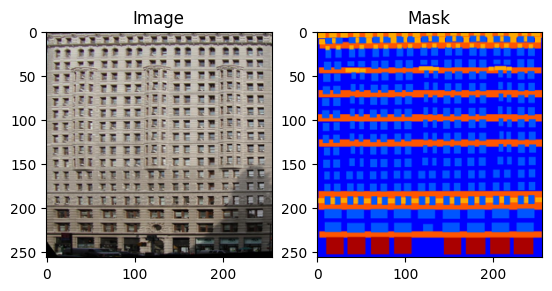

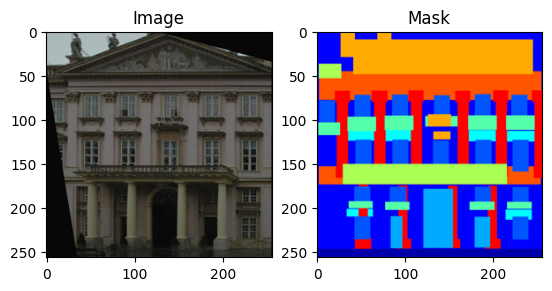

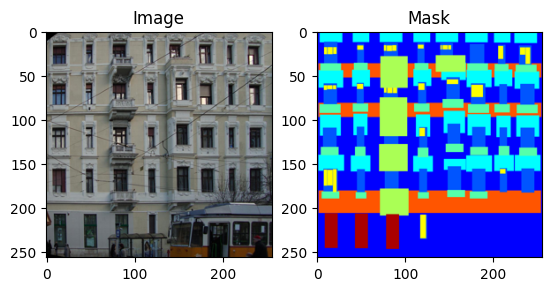

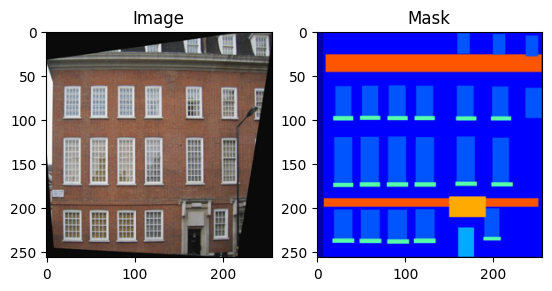

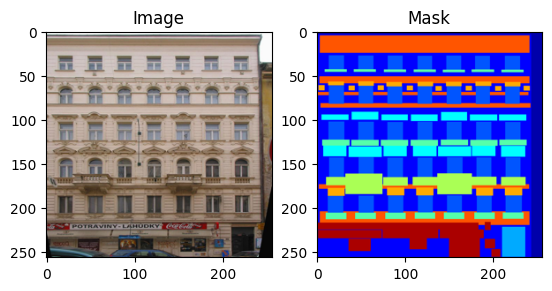

In [14]:
images, masks = next(iter(dataloader))

for i in range(5):
    image = reverse_transform(images[i])
    mask = reverse_transform(masks[i])
    plot2x2Array(image, mask)

Initialize our GAN

In [15]:
# Calculate output of image discriminator (PatchGAN)
patch_size = (1, img_height//2**3-2, img_width//2**3-2)

generator = generator.to(device)
discriminator = discriminator.to(device)
    
# Optimizers
optimizer_G = torch.optim.Adam(generator.parameters(), lr=lr, betas=(b1, b2))
optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(b1, b2))

Additional auxiliary functions

In [16]:
def save_model(epoch, loss_D, loss_G):
    # save your model weights
    torch.save({
                'epoch': epoch,
                'model_state_dict': generator.state_dict(),
                'optimizer_state_dict': optimizer_G.state_dict(),
                'loss': loss_G,
                }, 'generator_'+str(epoch)+'.pth')
    torch.save({
                'epoch': epoch,
                'model_state_dict': discriminator.state_dict(),
                'optimizer_state_dict': optimizer_D.state_dict(),
                'loss': loss_D,
                }, 'discriminator_'+str(epoch)+'.pth')
    
def weights_init_normal(m):
  classname = m.__class__.__name__
  if classname.find('Conv') != -1:
      torch.nn.init.normal_(m.weight.data, 0.0, 0.02)
  elif classname.find('BatchNorm2d') != -1:
      torch.nn.init.normal_(m.weight.data, 1.0, 0.02)
      torch.nn.init.constant_(m.bias.data, 0.0)

Train the model !  
But first, complete the loss function in the following training loop:  

In [17]:
# ----------
#  Training
# ----------

losses = []

# Initialize weights
generator.apply(weights_init_normal)
discriminator.apply(weights_init_normal)

# train the network
discriminator.train()
generator.train()
print_every = 400

for epoch in range(num_epochs):
    for i, batch in enumerate(dataloader):
        # Model inputs
        images, masks = batch
        images = images.to(device)
        masks = masks.to(device)

        # Discriminator labels
        valid = torch.ones((images.size(0), *patch_size), requires_grad=False).to(device)
        fake = torch.zeros((images.size(0), *patch_size), requires_grad=False).to(device)

        # ------------------
        #  Train Generators
        # ------------------

        optimizer_G.zero_grad()

        # GAN loss
        # TODO: Put here your GAN loss
        generated_images = generator(masks)
        predictions_D = discriminator(generated_images, masks)
        loss_GAN = criterion_GAN(predictions_D, valid)

        # Pixel-wise loss
        # TODO: Put here your pixel loss
        loss_pixel = criterion_pixelwise(generated_images, images)

        # Total loss
        # TODO: Put here your total loss for the generator
        loss_G = loss_GAN + lambda_pixel * loss_pixel

        loss_G.backward()
        optimizer_G.step()

        # ---------------------
        #  Train Discriminator
        # ---------------------

        optimizer_D.zero_grad()

        # Real loss
        pred_real = discriminator(images, masks)
        loss_real = criterion_GAN(pred_real, valid)

        # Fake loss
        pred_fake = discriminator(generated_images.detach(), masks)
        loss_fake = criterion_GAN(pred_fake, fake)

        # Total loss
        loss_D = 0.5 * (loss_real + loss_fake)

        loss_D.backward()
        optimizer_D.step()
        
        # Print some loss stats
        if i % print_every == 0:
            print(f'Epoch [{epoch+1}/{num_epochs}][{i}/{len(dataloader)}] | d_loss: {loss_D.item():6.4f} | g_loss: {loss_G.item():6.4f}')

    # Keep track of discriminator loss and generator loss
    losses.append((loss_D.item(), loss_G.item()))
        
    if (epoch + 1) % 100 == 0:
        print('Saving model...')
        save_model(epoch+1, loss_D, loss_G)


Epoch [1/200][0/22] | d_loss: 0.8825 | g_loss: 54.6875
Epoch [2/200][0/22] | d_loss: 0.3939 | g_loss: 20.9968
Epoch [3/200][0/22] | d_loss: 0.5146 | g_loss: 18.3553
Epoch [4/200][0/22] | d_loss: 0.3218 | g_loss: 18.1894
Epoch [5/200][0/22] | d_loss: 0.2179 | g_loss: 18.0815
Epoch [6/200][0/22] | d_loss: 0.3065 | g_loss: 18.7958
Epoch [7/200][0/22] | d_loss: 0.2480 | g_loss: 17.0464
Epoch [8/200][0/22] | d_loss: 0.2947 | g_loss: 16.5861
Epoch [9/200][0/22] | d_loss: 0.3191 | g_loss: 17.4756
Epoch [10/200][0/22] | d_loss: 0.5211 | g_loss: 15.3053
Epoch [11/200][0/22] | d_loss: 0.3123 | g_loss: 16.2690
Epoch [12/200][0/22] | d_loss: 0.6498 | g_loss: 14.2780
Epoch [13/200][0/22] | d_loss: 0.3107 | g_loss: 15.9667
Epoch [14/200][0/22] | d_loss: 0.6429 | g_loss: 15.9869
Epoch [15/200][0/22] | d_loss: 0.7044 | g_loss: 15.0235
Epoch [16/200][0/22] | d_loss: 0.4700 | g_loss: 14.0488
Epoch [17/200][0/22] | d_loss: 0.4090 | g_loss: 12.7302
Epoch [18/200][0/22] | d_loss: 0.5440 | g_loss: 12.7965
E

Observation of the loss along the training

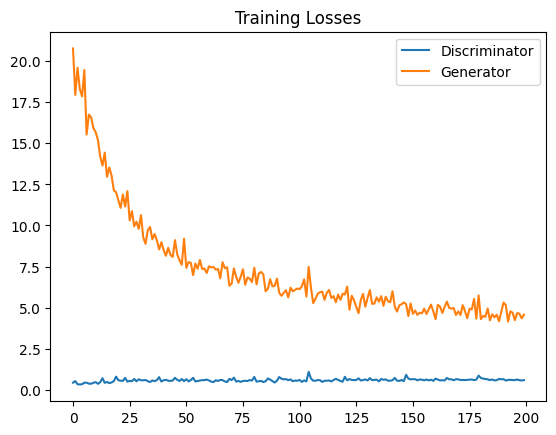

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator')
plt.plot(losses.T[1], label='Generator')
plt.title("Training Losses")
plt.legend()

If the training takes too much time, you can use a pretrained model in the meantime, to evaluate its performance.

It is available at : https://partage.liris.cnrs.fr/index.php/s/xwEFmxn9ANeq4zY

### Evaluate your cGAN

In [35]:
def load_model(epoch=200):
    if 'generator_'+str(epoch)+'.pth' in os.listdir("models") and 'discriminator_'+str(epoch)+'.pth' in os.listdir("models"):
        checkpoint_generator = torch.load('models/generator_'+str(epoch)+'.pth', map_location=device)
        generator.load_state_dict(checkpoint_generator['model_state_dict'])
        optimizer_G.load_state_dict(checkpoint_generator['optimizer_state_dict'])
        epoch_G = checkpoint_generator['epoch']
        loss_G = checkpoint_generator['loss']

        checkpoint_discriminator = torch.load('models/discriminator_'+str(epoch)+'.pth', map_location=device)
        discriminator.load_state_dict(checkpoint_discriminator['model_state_dict'])
        optimizer_D.load_state_dict(checkpoint_discriminator['optimizer_state_dict'])
        epoch_D = checkpoint_discriminator['epoch']
        loss_D = checkpoint_discriminator['loss']
        
    else:
        print('There isn\' a training available with this number of epochs')

In [20]:
load_model(epoch=200)

# switching mode
generator.eval()

C:\Users\paull\AppData\Local\Temp\ipykernel_11932\1301985785.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint_generator = torch.load('generator_'+str(epoch)+'.

U_Net(
  (inc): inconv(
    (conv): Sequential(
      (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
    )
  )
  (down1): down(
    (conv): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
  )
  (down2): down(
    (conv): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
  )
  (down3): down(
    (conv): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inpla

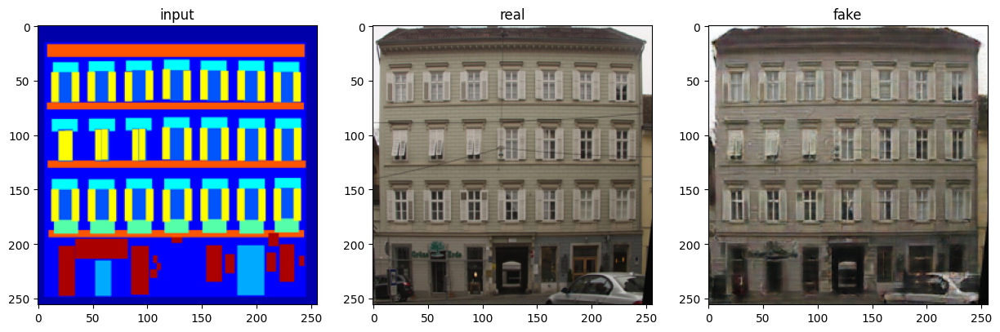

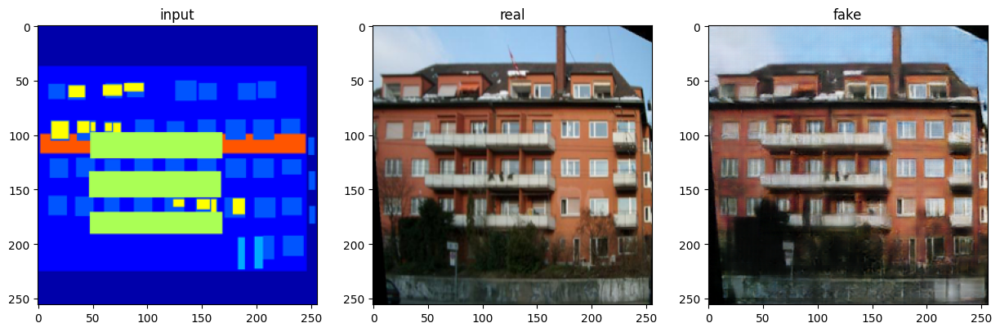

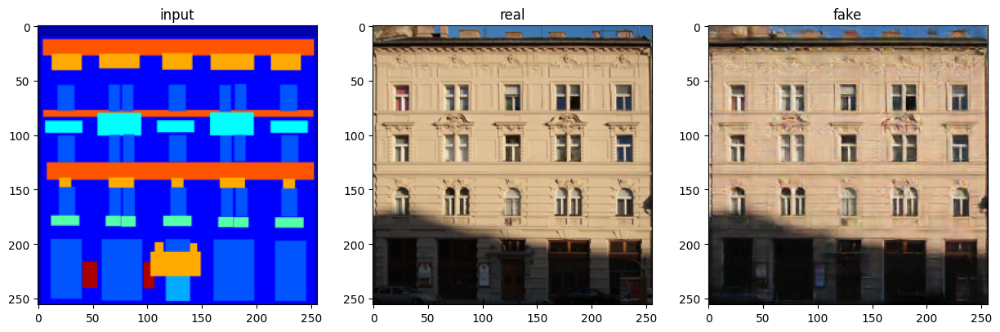

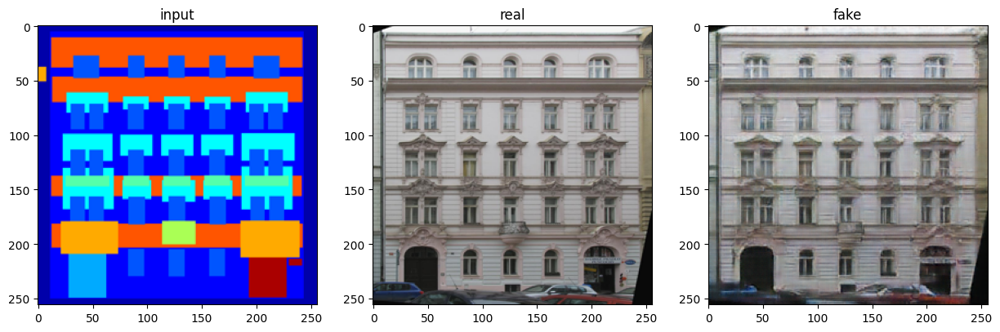

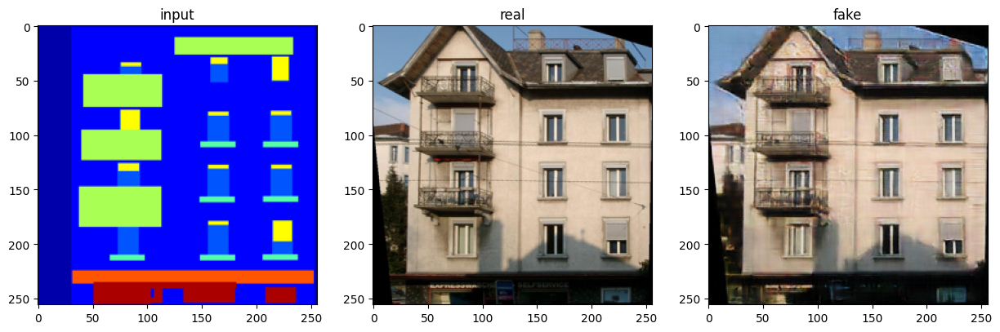

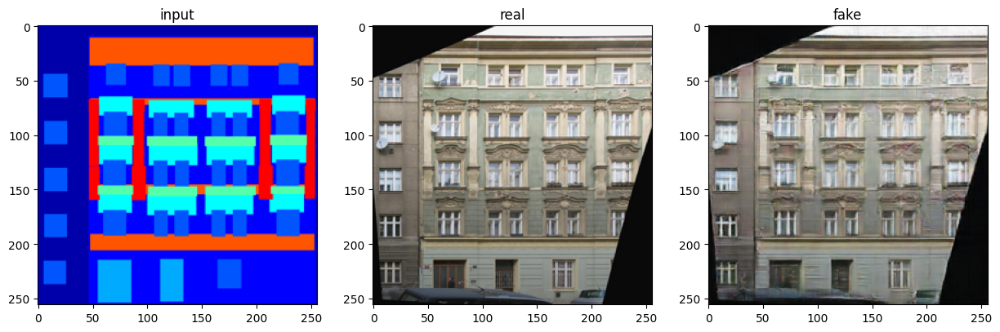

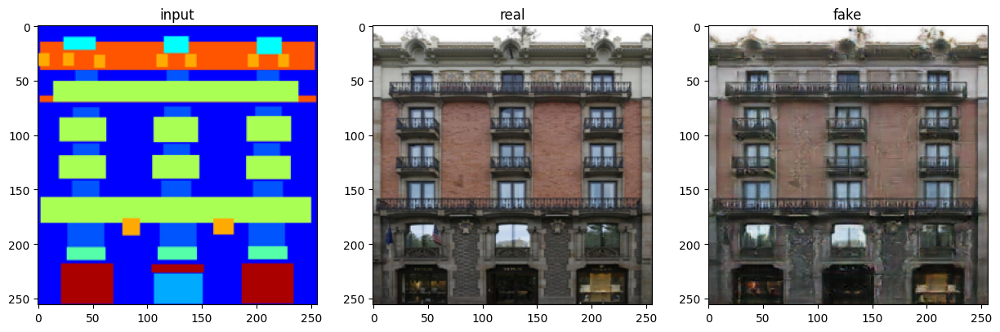

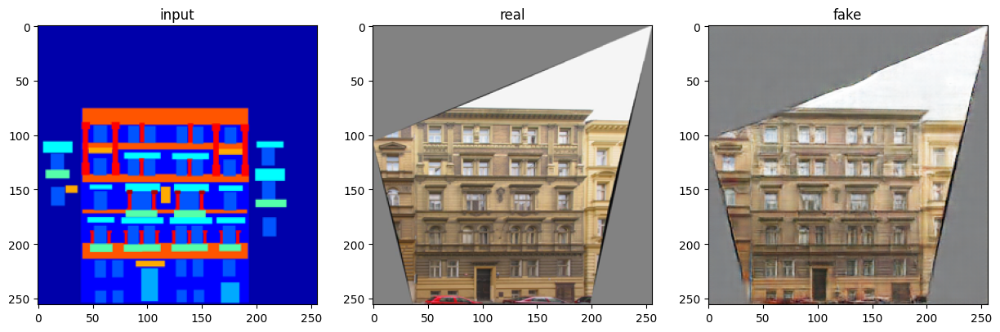

In [21]:
# show a sample evaluation image on the training base
image, mask = next(iter(dataloader))
output = generator(mask.to(device))
output = output.cpu().detach()

for i in range(8):
    image_plot = reverse_transform(image[i])
    output_plot = reverse_transform(output[i])
    mask_plot = reverse_transform(mask[i])
    plot2x3Array(mask_plot,image_plot,output_plot)

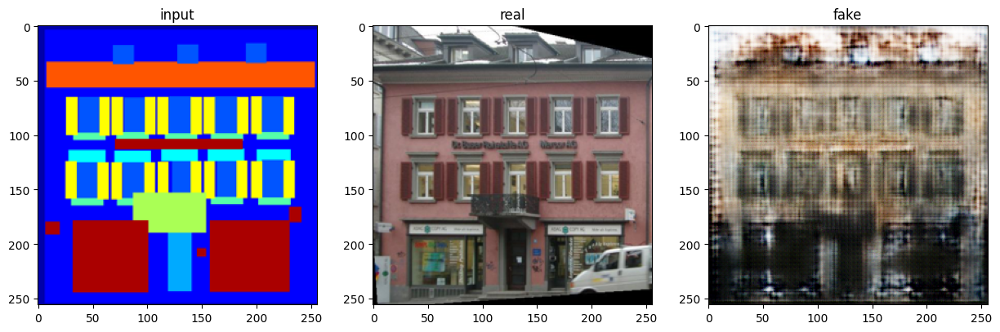

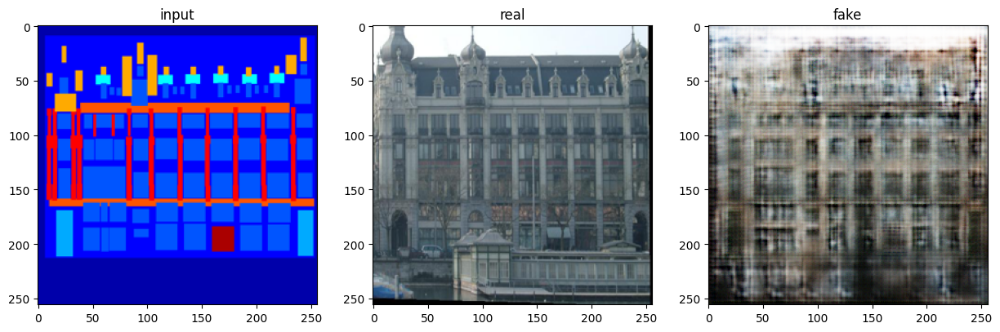

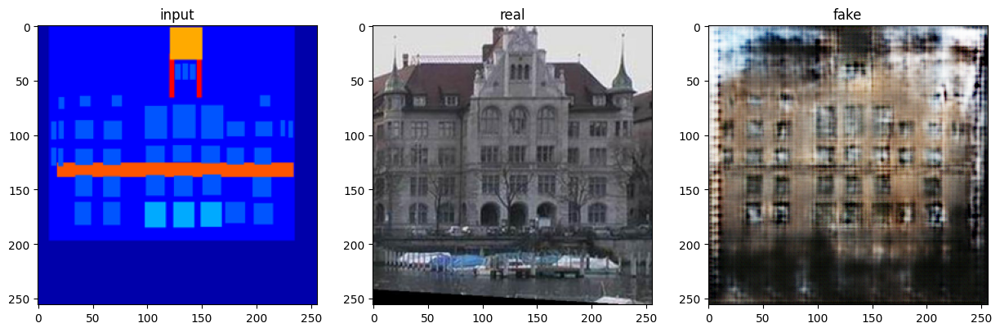

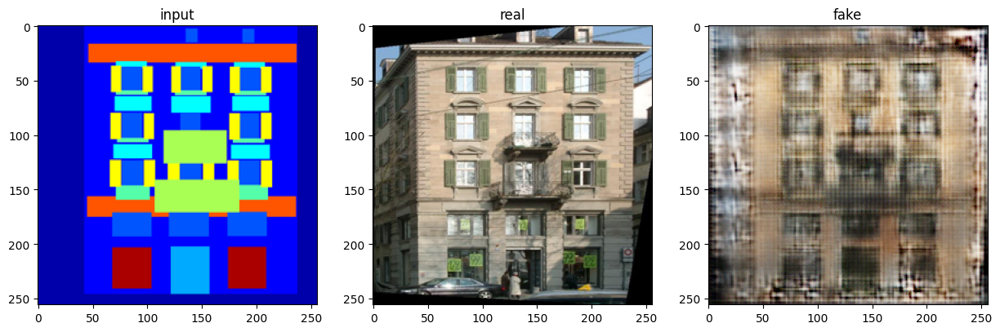

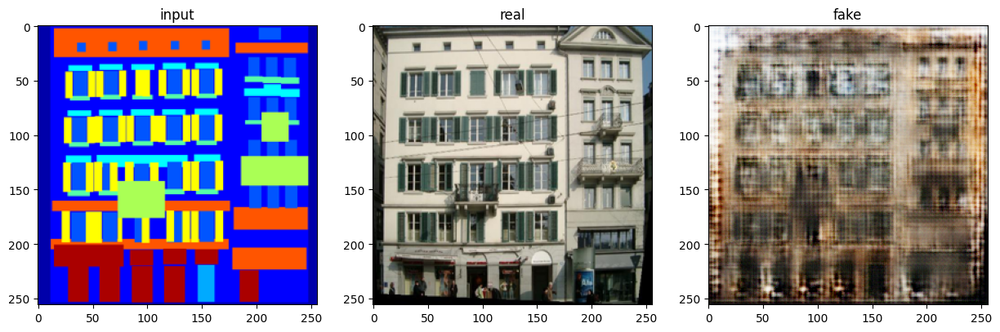

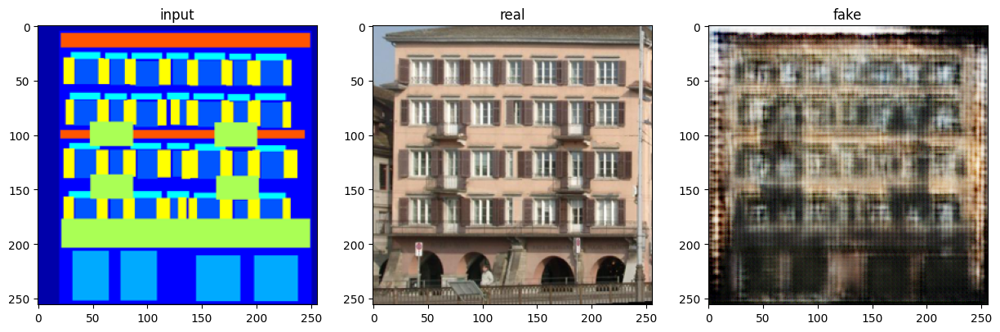

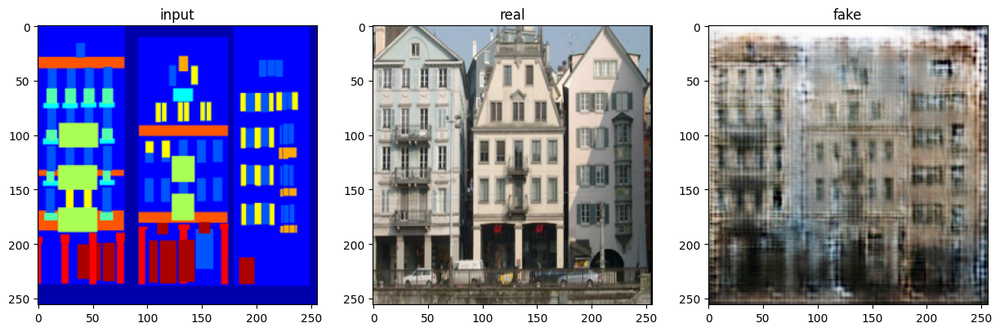

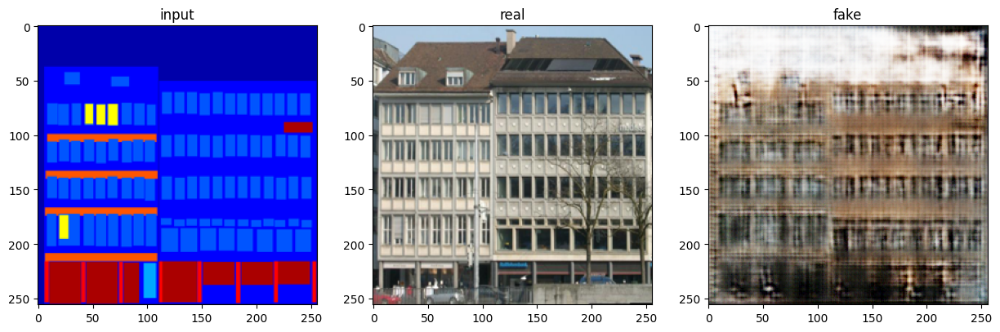

In [38]:
# show a sample evaluation image on the validation base
image, mask = next(iter(val_dataloader))
output = generator(mask.to(device))
output = output.cpu().detach()

for i in range(8):
    image_plot = reverse_transform(image[i])
    output_plot = reverse_transform(output[i])
    mask_plot = reverse_transform(mask[i])
    plot2x3Array(mask_plot,image_plot,output_plot)

<font color='red'>**Question**</font>                                                                  
Compare results of your model after 100 and 200 epochs

C:\Users\paull\AppData\Local\Temp\ipykernel_11932\633185073.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint_generator = torch.load('models/generator_'+str(epo

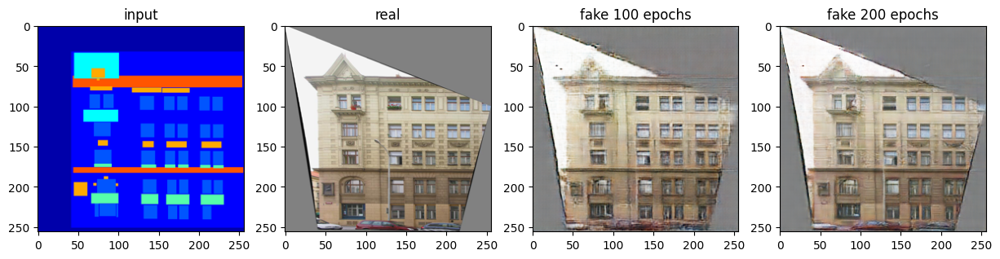

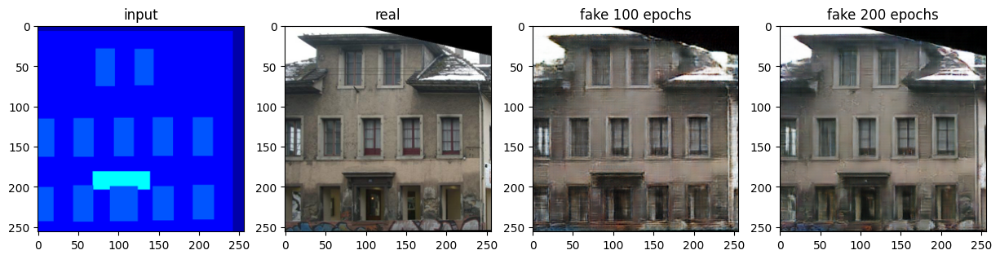

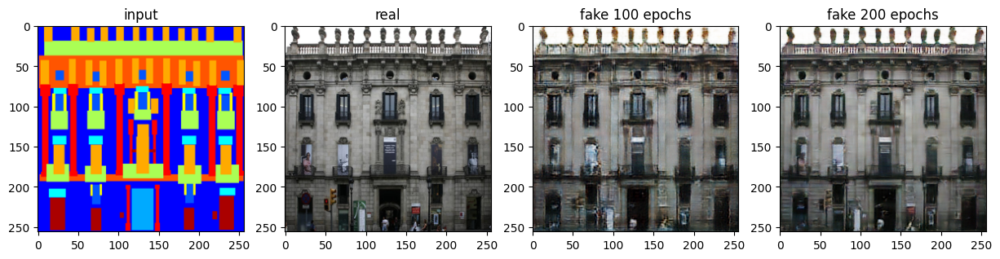

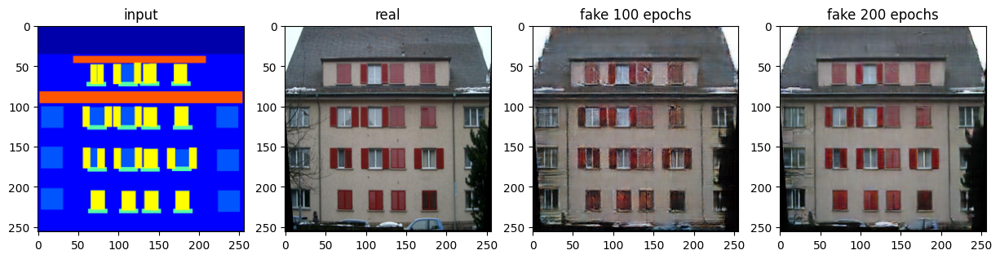

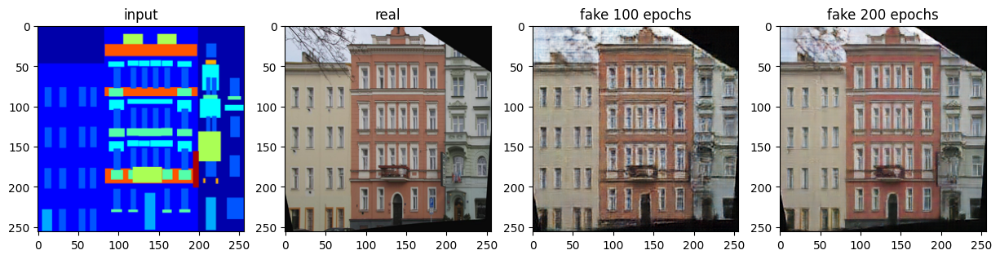

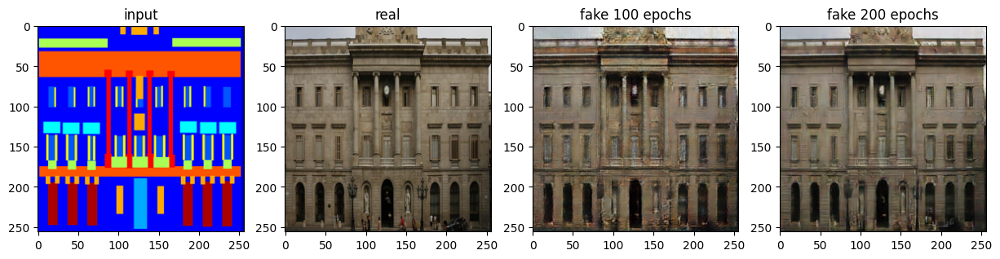

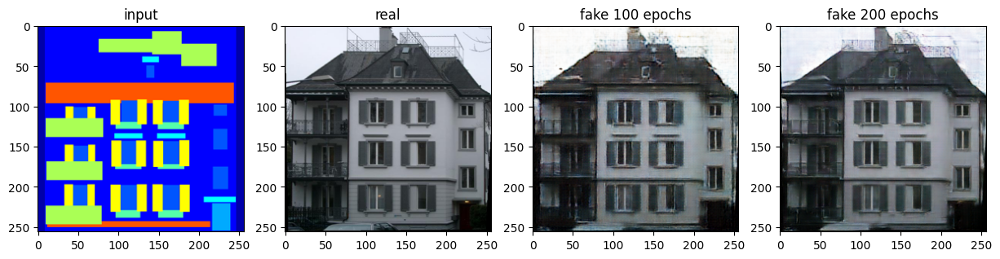

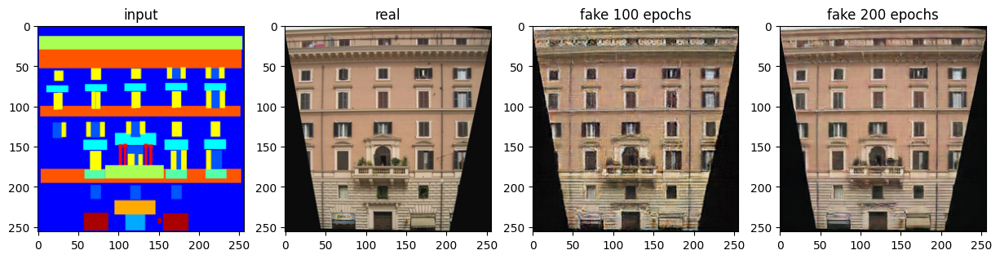

In [36]:
# TODO : Your code here to load and evaluate with a few samples the 2 checkpoints (100 epochs and 200 epochs)

def plot2x4Array(image, mask, predict_100, predict_200):
    f, axarr = plt.subplots(1,4,figsize=(15,15))
    axarr[0].imshow(image)
    axarr[1].imshow(mask)
    axarr[2].imshow(predict_100)
    axarr[3].imshow(predict_200)
    axarr[0].set_title('input')
    axarr[1].set_title('real')
    axarr[2].set_title('fake 100 epochs')
    axarr[3].set_title('fake 200 epochs')

image, mask = next(iter(dataloader))
load_model(epoch=100)
output_100 = generator(mask.to(device))
output_100 = output_100.cpu().detach()

load_model(epoch=200)
output_200 = generator(mask.to(device))
output_200 = output_200.cpu().detach()

for i in range(8):
    image_plot = reverse_transform(image[i])
    output_100_plot = reverse_transform(output_100[i])
    output_200_plot = reverse_transform(output_200[i])
    mask_plot = reverse_transform(mask[i])
    plot2x4Array(mask_plot,image_plot,output_100_plot,output_200_plot)


C:\Users\paull\AppData\Local\Temp\ipykernel_11932\633185073.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint_generator = torch.load('models/generator_'+str(epo

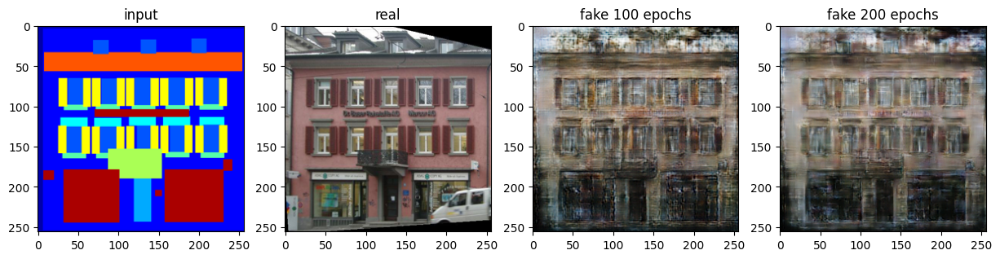

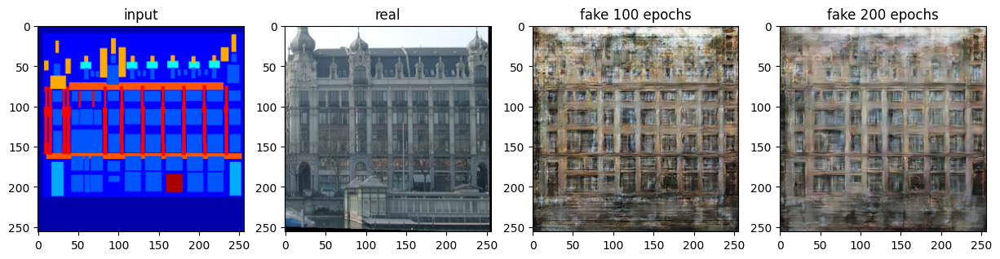

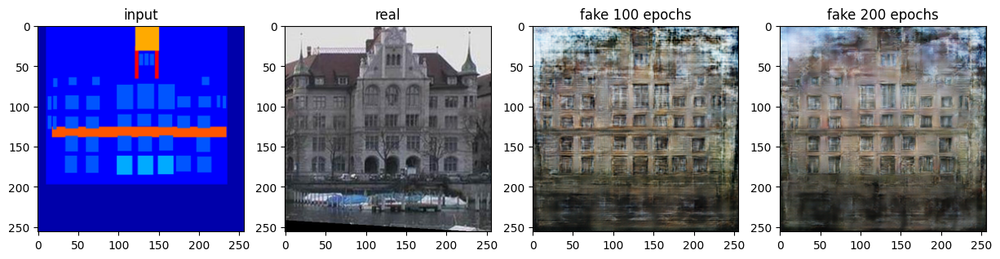

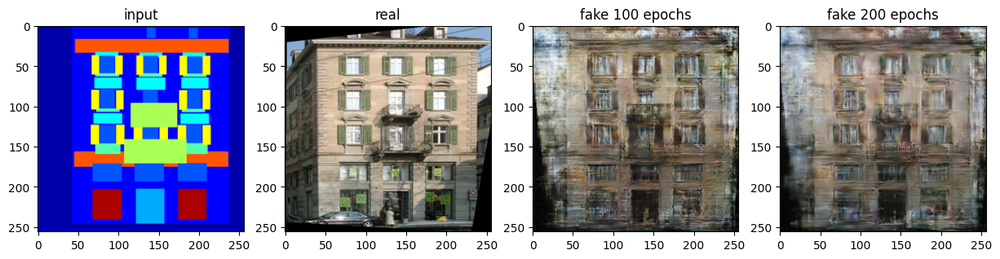

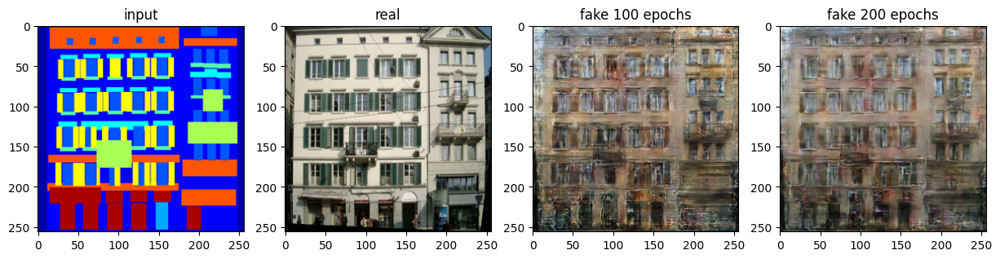

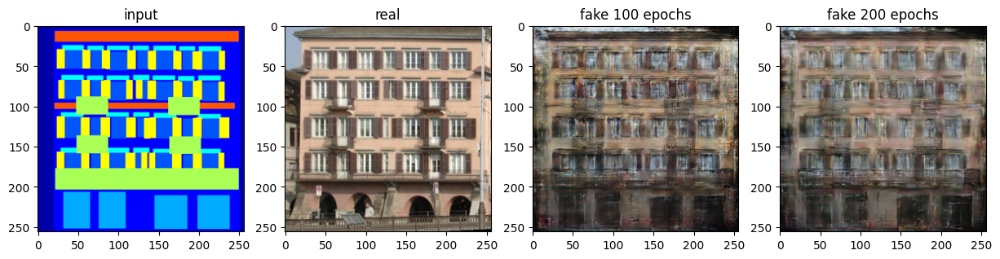

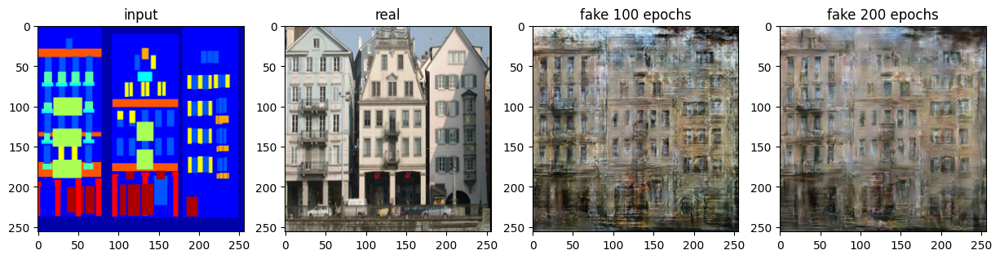

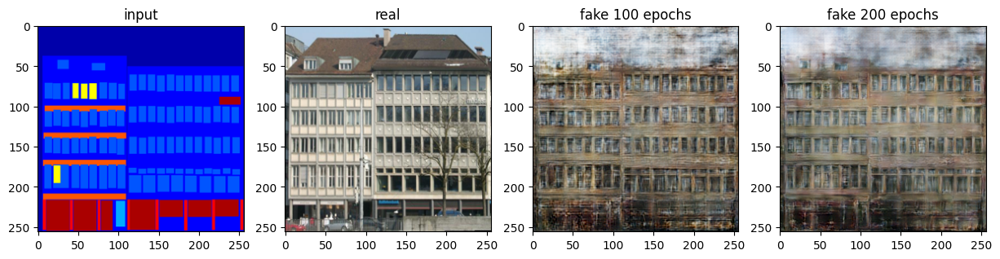

In [37]:
# show a sample evaluation image on the validation base
image, mask = next(iter(val_dataloader))
load_model(epoch=100)
output_100 = generator(mask.to(device))
output_100 = output_100.cpu().detach()

load_model(epoch=200)
output_200 = generator(mask.to(device))
output_200 = output_200.cpu().detach()

for i in range(8):
    image_plot = reverse_transform(image[i])
    output_100_plot = reverse_transform(output_100[i])
    output_200_plot = reverse_transform(output_200[i])
    mask_plot = reverse_transform(mask[i])
    plot2x4Array(mask_plot,image_plot,output_100_plot,output_200_plot)

Wether it is on the training or on the validation dataset, there isn't significative differences between the two images.
On the training dataset, We can notice that the model with 200 epochs is better to recreate the details (beginning of overfitting).
On the validation dataset, the generated image from de 200 epochs models are less noisy.

# Part 3: Diffusion

Diffusion models are probabilistic generative models which learn to generate data by iteratively refining random noise through a reverse diffusion process. Given a sample of data, noise is progressvely added in small steps until it becomes pure noise. Then, a neural network is trained to reverse this process and generate realistic data from noise.  

<p align="center">
<img height=300px src="https://substackcdn.com/image/fetch/f_auto,q_auto:good,fl_progressive:steep/https%3A%2F%2Fsubstack-post-media.s3.amazonaws.com%2Fpublic%2Fimages%2F2f5d7da7-52db-4104-9742-a0b4555d8dd6_1300x387.png"/></p>
<p align="center"></p>

Diffusion models have gained popularity due to their ability to generate high-quality, diverse, and detailed content, surpassing GANs in the quality of the generated images.  

In this assignment we will focus on DDPMs, which were introduced in this [paper](https://arxiv.org/abs/2006.11239) and laid the foundation for generative diffusion models.









For this part, we will use the MNIST dataset, used in part 1

In [2]:
image_size = 64
workers = 0
batch_size = 128

mnist_dataset = dset.MNIST('data', 
                  download=True, 
                  transform=transforms.Compose([
                      transforms.Resize(image_size),
                      transforms.CenterCrop(image_size),
                      transforms.ToTensor(),
                      transforms.Normalize((0.5,), (0.5,)),
                    ]),
                )

mnist_dataloader = torch.utils.data.DataLoader(mnist_dataset, batch_size=batch_size, shuffle=True, num_workers=workers)

Auxiliary function for plotting images

In [5]:
def plot1xNArray(images, labels):
    f, axarr = plt.subplots(1, len(images))
    
    for image, ax, label in zip(images, axarr, labels):
        ax.imshow(image, cmap='gray')
        ax.axis('off')
        ax.set_title(label)

def reverse_transform(image):
    image = image.numpy().transpose((1, 2, 0))
    image = np.clip(image, 0, 1)
    image = (image * 255).astype(np.uint8)

    return image

In order to train the model with the diffusion process, we will use a noise scheduler, which will be in charge of the forward diffusion process. The scheduler takes an image, a sample of random noise and a timestep, and return a noisy image for the corresponding timestep. Noise is progressvely added to the image at each timestep, therefore a noisy image at timestep 0 will have barely any noise while a noisy image at the maximum timestep will be basically just noise.  

Let's create a noise scheduler with 1000 max timesteps and visualize some noise images.  

We will use the diffusers library, which provides several tools for training and using diffusion models.  

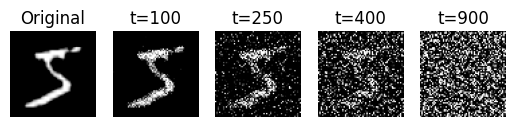

In [6]:
from diffusers import DDPMScheduler

# TODO: Create the scheduler
noise_scheduler = DDPMScheduler(num_train_timesteps=1000)

image, _ = mnist_dataset[0]

# TODO: Create a noise tensor sampled from a normal distribution with the same shape as the image
noise = torch.randn_like(image)

images, labels = [reverse_transform(image)], ["Original"]

for i in [100, 250, 400, 900]:
    timestep = torch.LongTensor([i])
    noisy_image = noise_scheduler.add_noise(image, noise, timestep)
    images.append(reverse_transform(noisy_image))
    labels.append(f"t={i}")

plot1xNArray(images, labels)

For the reverse diffusion process we will use a neural network. Given a noisy image and the corresponding timestep, the goal of the neural network is to predict the noise, which allows for the denoising.  

For the model, we will have a similar architecture as we used for the cGAN generator, a 2D UNet with a few modifications. The main difference will be that we have to indicate to the model which timestep is currently being denoised. For that purpose a timestep embedding is added, therefore the model has 2 inputs, the noisy image and the corresponding timestep.  
  
In this exercise, we will use an UNet implementation from the diffusers library, which already has the timestep embedding included.

In [7]:
from diffusers import UNet2DModel

# TODO: Complete the parameters
diffusion_backbone = UNet2DModel(
                        block_out_channels=(64, 128, 256, 512),
                        down_block_types=("DownBlock2D", "DownBlock2D", "DownBlock2D", "DownBlock2D"),
                        up_block_types=("UpBlock2D", "UpBlock2D", "UpBlock2D", "UpBlock2D"),
                        sample_size=image_size,
                        in_channels=1,
                        out_channels=1,
                    ).to(device)
   
# Optimizer
optimizer = torch.optim.AdamW(diffusion_backbone.parameters(), lr=1e-4)

print(diffusion_backbone)

UNet2DModel(
  (conv_in): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (time_proj): Timesteps()
  (time_embedding): TimestepEmbedding(
    (linear_1): Linear(in_features=64, out_features=256, bias=True)
    (act): SiLU()
    (linear_2): Linear(in_features=256, out_features=256, bias=True)
  )
  (down_blocks): ModuleList(
    (0): DownBlock2D(
      (resnets): ModuleList(
        (0-1): 2 x ResnetBlock2D(
          (norm1): GroupNorm(32, 64, eps=1e-05, affine=True)
          (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (time_emb_proj): Linear(in_features=256, out_features=64, bias=True)
          (norm2): GroupNorm(32, 64, eps=1e-05, affine=True)
          (dropout): Dropout(p=0.0, inplace=False)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (nonlinearity): SiLU()
        )
      )
      (downsamplers): ModuleList(
        (0): Downsample2D(
          (conv): Conv2d(64, 64, ker

<font color='red'>Question</font>  
What are the differences between the UNet used for the cGAN generator and the one defined above ?  
Indicate the differences in the architecture by analyzing both models \_\_str\_\_.

Summary of key differences :
|       **Feature**      |               **UNet for cGAN**              |               **UNet for Diffusion**              |
|:----------------------:|:--------------------------------------------:|:-------------------------------------------------:|
| **Purpose**            | Image-to-image translation (GAN   generator) | Denoising step in diffusion models                |
| **Activation**         | LeakyReLU (encoder), ReLU   (decoder)        | SiLU (Swish)                                      |
| **Downsampling**       | Conv2D with stride 2                         | ResNet blocks + Downsample2D                      |
| **Upsampling**         | ConvTranspose2D                              | ResNet blocks + Upsample2D                        |
| **Skip   Connections** | Simple concatenation                         | Processed via ResNet layers                       |
| **Normalization**      | BatchNorm                                    | GroupNorm                                         |
| **Bottleneck**         | No explicit bottleneck                       | Includes time embeddings for   denoising schedule |
| **Output**             | Tanh activation                              | Outputs noise prediction                          |

<font color='green'>**Bonus**</font>   
**Extend** the code of the UNet used in part 2 to add the timestep conditioning. Train it in the same way as the UNet2DModel from the diffusers library (using the DDPMScheduler) and compare the results. As in the first bonus exercise, add a label conditioning which allows to control the output of the model (i.e. generate a specific handwritten digit (e.g. "4") instead of a random one). Test the model, showcasing some examples.

Now, let's train the model

In [8]:
# ----------------
#  Training Loop
# ----------------
# torch.backends.cudnn.deterministic = True
torch.use_deterministic_algorithms(False)

losses = []
num_epochs = 5
print_every = 1

diffusion_backbone.train()

for epoch in range(num_epochs):
    for i, batch in enumerate(mnist_dataloader):
        # Zero the gradients
        optimizer.zero_grad()

        # Send input to device
        images = batch[0].to(device)

        # Generate noisy images, different timestep for each image in the batch
        timesteps = torch.randint(noise_scheduler.config.num_train_timesteps, (images.size(0),), device=device)

        # TODO: Complete the code
        noise = torch.randn_like(images)
        noisy_images = noise_scheduler.add_noise(images, noise, timesteps)

        # Forward pass
        residual = diffusion_backbone(noisy_images, timesteps).sample
        
        # TODO: Compute the loss
        loss = torch.nn.functional.mse_loss(residual, images)
        
        loss.backward()
        optimizer.step()

        # Print stats
        if i % print_every == 0:
            print(f'Epoch [{epoch+1}/{num_epochs}][{i}/{len(mnist_dataloader)}] | loss: {loss.item():6.4f}')

    losses.append(loss.item())
    torch.save(diffusion_backbone.state_dict(), f"diffusion_{epoch+1}.pth")

c:\Users\paull\miniforge3\envs\epsa_yolo\lib\site-packages\diffusers\models\attention_processor.py:3286: UserWarning: 1Torch was not compiled with flash attention. (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\transformers\cuda\sdp_utils.cpp:555.)
  hidden_states = F.scaled_dot_product_attention(


Epoch [1/5][0/469] | loss: 0.9864
Epoch [1/5][1/469] | loss: 0.5935
Epoch [1/5][2/469] | loss: 0.3878
Epoch [1/5][3/469] | loss: 0.2703
Epoch [1/5][4/469] | loss: 0.2332
Epoch [1/5][5/469] | loss: 0.2096
Epoch [1/5][6/469] | loss: 0.2227


KeyboardInterrupt: 

The training takes 10 min to train on 7 batches, so in the following, I will use the given model in the link below

If the training takes too long, you can download an already trained model from [this link](https://partage.liris.cnrs.fr/index.php/s/AP2t6b3w8SM4Bp5) and use it for inference. 

In [ ]:
# TODO: Add the path to the model checkpoint for loading the model

diffusion_backbone.load_state_dict(torch.load("models/diffusion_5.pth"))
diffusion_backbone.eval()

C:\Users\paull\AppData\Local\Temp\ipykernel_10028\3979747804.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  diffusion_backbone.load_state_dict(torch.load("models/diffus

UNet2DModel(
  (conv_in): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (time_proj): Timesteps()
  (time_embedding): TimestepEmbedding(
    (linear_1): Linear(in_features=64, out_features=256, bias=True)
    (act): SiLU()
    (linear_2): Linear(in_features=256, out_features=256, bias=True)
  )
  (down_blocks): ModuleList(
    (0): DownBlock2D(
      (resnets): ModuleList(
        (0-1): 2 x ResnetBlock2D(
          (norm1): GroupNorm(32, 64, eps=1e-05, affine=True)
          (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (time_emb_proj): Linear(in_features=256, out_features=64, bias=True)
          (norm2): GroupNorm(32, 64, eps=1e-05, affine=True)
          (dropout): Dropout(p=0.0, inplace=False)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (nonlinearity): SiLU()
        )
      )
      (downsamplers): ModuleList(
        (0): Downsample2D(
          (conv): Conv2d(64, 64, ker

Time to generate some images.  

During training, for each data sample, we take a random timestep and correspondent noisy image to give it as input to our model. With suffitient training, the model should learn how to predict the noise in a noisy image for all possible timesteps.  

During inference, to generate an image, we will start from pure noise and step by step predict the noise to go from one noisy image to the next, progressively denoising the image until we reach the timestep 0, in which we should have an image without any noise.

100%|██████████| 1000/1000 [01:26<00:00, 11.50it/s]


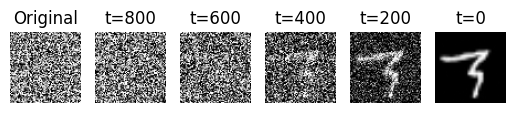

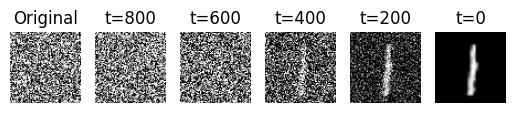

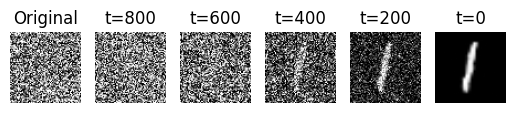

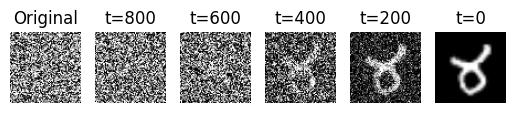

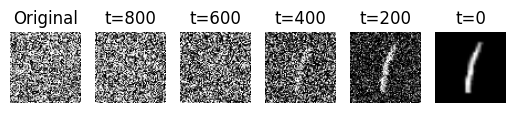

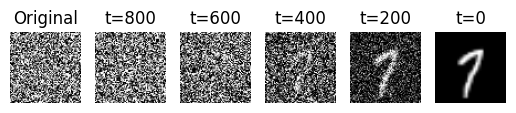

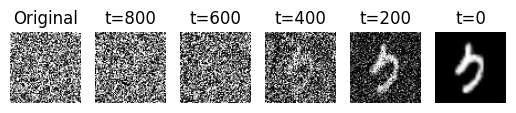

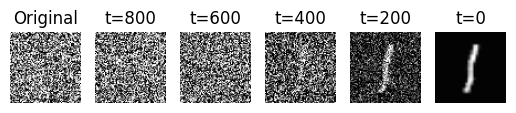

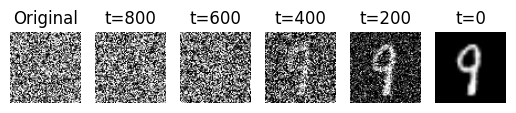

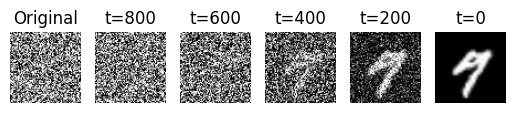

In [ ]:
from tqdm import tqdm

# Start the image as random noise
image = torch.randn((10, 1, 64, 64)).to(device)

# Create a list of images and labels for visualization
images, labels = [(image / 2 + 0.5).clamp(0, 1).cpu().permute(0, 2, 3, 1).numpy()], ["Original"]

# Use the scheduler to iterate over timesteps
noise_scheduler.set_timesteps(1000)

for timestep in tqdm(noise_scheduler.timesteps):
    with torch.no_grad():
        residual = diffusion_backbone(image, timestep).sample
        image = noise_scheduler.step(residual, timestep, image).prev_sample

    if timestep.item() % 200 == 0:
        images.append((image / 2 + 0.5).clamp(0, 1).cpu().permute(0, 2, 3, 1).numpy())
        labels.append(f"t={timestep.item()}")

for i in range(images[0].shape[0]):
    plot1xNArray([img[i] for img in images], labels)

The diffusers library also provides *Pipeline* classes, which are wrappers around the model that abstracts the inference loop implemented above.  
  
We can create a pipeline, giving it the trained model and the noise scheduler, and use it to generate images. In this case, we will only have access to the final image, generated on the last timestep, but not the intermediary images from the denoising process.  

  0%|          | 0/1000 [00:00<?, ?it/s]

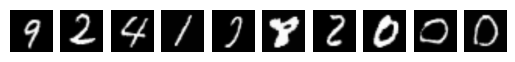

In [ ]:
from diffusers import DDPMPipeline

pipeline = DDPMPipeline(diffusion_backbone, noise_scheduler)
generated_images = pipeline(10, output_type="np")

f, axarr = plt.subplots(1, len(generated_images["images"]))

for image, ax in zip(generated_images["images"], axarr):
    ax.imshow(image, cmap='gray')
    ax.axis('off')

# Part 4: What about those beautiful images ?

<p align="center">
<img height=300px src="https://huggingface.co/stabilityai/stable-diffusion-3.5-large/media/main/sd3.5_large_demo.png"/></p>
<p align="center"></p>

In this exercise we achieved decent results for very simple datasets. But we are quite far from those beautiful AI generated images we can find online. That is for 2 main reasons:
- Model size: due to the computation and time constrains, we can't really train very large models 
- Dataset size: due to the same constrains, we can't use very complex and large datasets, which requires larger models and longer training times.

Fortunatly, even though we can train those large models with the available hardware and time, we can at least use them for inference !  

The goal of this part is to learn how to retrive and use a pre-trained diffusion models and also to get creative to come up with some nice prompts to generate cool images.  

We are going to use Stable Diffusion 3.5, which is a state of the art open-source text conditioned model. It takes a prompt in natural language and use it to guide the diffusion process. This type of models are trained with image-text pairs, but can generalize beyond the pairs seen during training, being able to mix several different concepts into a single image.  

In order to save memory, we will use quantization, which consists into converting the model weights types from float16 into float4. That simply means that each model weight will be stored using only 4 bits instead of 16 bits. That allows us to run the model in GPUs with less VRAM and have faster inference, with a small drop in the quality of the results.

For this part of the assignment restart the notebook kernel to be sure your GPU memory is empty. The memory usage can be verified using the command `nvidia-smi` in a terminal. If your GPU has 2GB of VRAM or less, the model will probably not fit into memory even with quantization. In that case, use Google Colab for this part or use the smaller model indicated below. If you are not happy with the results and have plenty of VRAM available, feel free to increase the quantization to 8 bits or even load the model without quantization.

Before downloading the model, got to its [HuggingFace page](https://huggingface.co/stabilityai/stable-diffusion-3.5-medium), log in with your account and accept the terms of use.

In [1]:
from diffusers import BitsAndBytesConfig, SD3Transformer2DModel
from diffusers import StableDiffusion3Pipeline
import torch
from huggingface_hub import notebook_login
import transformers
import sentencepiece
# notebook_login()

model_id = "stabilityai/stable-diffusion-3.5-medium"

nf4_config = BitsAndBytesConfig(
    load_in_4bit=True,
    bnb_4bit_quant_type="nf4",
    bnb_4bit_compute_dtype=torch.float16
)
model_nf4 = SD3Transformer2DModel.from_pretrained(
    model_id,
    subfolder="transformer",
    quantization_config=nf4_config,
    torch_dtype=torch.float16
)

pipeline = StableDiffusion3Pipeline.from_pretrained(
    model_id, 
    transformer=model_nf4,
    torch_dtype=torch.float16
)
pipeline.enable_model_cpu_offload(device="cuda")
torch.use_deterministic_algorithms(False)
# TODO: test different prompts and visualize the generated images
# Once you are happy with the results, you can save 3 differet images as png file with the correspondent prompts in a text file
# Don't forget to add the images and prompts in your gitlab submission!
prompt = "An astronaut dog walking on the moon"

print(prompt)
image = pipeline(
    prompt=prompt,
    num_inference_steps=40,
    guidance_scale=4.5,
    max_sequence_length=512
).images[0]
image.save("generated_image_1.png")

# prompt = "A cute little burger, with arms and eyes, driving a car, childish style"
# print(prompt)
# image = pipeline(
#     prompt=prompt,
#     num_inference_steps=40,
#     guidance_scale=4.5,
#     max_sequence_length=512
# ).images[0]
# image.save("generated_image_2.png")

# prompt = "A donkey listening to music in the train"
# image = pipeline(
#     prompt=prompt,
#     num_inference_steps=40,
#     guidance_scale=4.5,
#     max_sequence_length=512
# ).images[0]
# image.save("generated_image_3.png")


Loading pipeline components...:   0%|          | 0/9 [00:00<?, ?it/s]

You set `add_prefix_space`. The tokenizer needs to be converted from the slow tokenizers


Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

An astronaut dog walking on the moon


c:\Users\paull\miniforge3\envs\epsa_yolo\lib\site-packages\transformers\models\clip\modeling_clip.py:540: UserWarning: 1Torch was not compiled with flash attention. (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\transformers\cuda\sdp_utils.cpp:555.)
  attn_output = torch.nn.functional.scaled_dot_product_attention(


  0%|          | 0/40 [00:00<?, ?it/s]

If even with the quantization you still run out of GPU memory and you can't use Google Colab, you can use the following code instead, which uses a much smaller model (the results won't be as near as impressive, but it should be able to run even on a CPU, if you have a little patience)

Here are the generated images :

Prompt : "An astronaut dog walking on the moon"

![An astronaut dog walking on the moon](generated_image_1.png)

Prompt : "A cute little burger, with arms and eyes, driving a car, childish style"

![A cute little burger, with arms and eyes, driving a car, childish style](generated_image_2.png)

Prompt : "A donkey listening to music in the train"

![A donkey listening to music in the train](generated_image_3.png)

# How to submit your Work ?

This work must be done individually. The expected output is a private repository named gan-diffusion on https://gitlab.ec-lyon.fr. It must contain your notebook (or python files), a README.md file that explains briefly the successive steps performed, the model checkpoints, and the generated images. Don't forget to add your teacher as developer member of the project. The last commit is due before 11:59 pm on Wednesday, April 9th, 2025. Subsequent commits will not be considered.